# Previsão da idade de abalones a partir de características físicas

Haliotis é um gênero de moluscos gastrópodes marinhos da família Haliotidae e o único gênero catalogado desta família. Foi proposto por Linnaeus em 1758 e contém diversas espécies em águas costeiras de quase todo o mundo. Na gastronomia, o abalone é um molusco valorizado em países asiáticos.<br />

A idade do abalone é determinada cortando a concha através do cone, colorindo-a e contando o número de anéis através de um microscópio - uma tarefa tediosa e demorada. Outras medidas, mais fáceis de obter, são utilizadas para prever a idade. Informações adicionais, como padrões climáticos e localização (portanto, disponibilidade de alimentos) podem ser necessárias para resolver o problema.

Fonte: https://archive.ics.uci.edu/ml/datasets/abalone




In [256]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

from sklearn import preprocessing 
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, accuracy_score

import ipyplot

%matplotlib inline

In [257]:
img_list = ['https://upload.wikimedia.org/wikipedia/commons/thumb/1/18/Haliotis_squamosa_001.jpg/180px-Haliotis_squamosa_001.jpg',
            'https://upload.wikimedia.org/wikipedia/commons/thumb/2/2c/Haliotis_rugosa_pustulata_001.jpg/180px-Haliotis_rugosa_pustulata_001.jpg',
            'https://upload.wikimedia.org/wikipedia/commons/thumb/7/74/Haliotis_parva_002.jpg/180px-Haliotis_parva_002.jpg',
            'https://upload.wikimedia.org/wikipedia/commons/thumb/a/a0/AbaloneMeat.jpg/180px-AbaloneMeat.jpg'
]

ipyplot.plot_images(img_list, img_width=200)  

In [258]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4177 entries, 0 to 4176
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   sex             4177 non-null   object 
 1   length          4177 non-null   float64
 2   diameter        4177 non-null   float64
 3   height          4177 non-null   float64
 4   whole_weight    4177 non-null   float64
 5   shucked_weight  4177 non-null   float64
 6   viscera_weight  4177 non-null   float64
 7   shell_weight    4177 non-null   float64
 8   rings           4177 non-null   int64  
dtypes: float64(7), int64(1), object(1)
memory usage: 293.8+ KB


In [259]:
df = pd.read_csv('datasets/abalone.data')
df.head()

,sex,length,diameter,height,whole_weight,shucked_weight,viscera_weight,shell_weight,rings
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.150,15
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.070,7
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,9
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.155,10
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.055,7


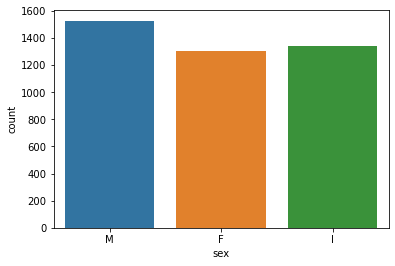

In [260]:
# Analisando o balanceamento dos dados através da quantidade de amostras por sexo
sns.countplot(x='sex', data=df)

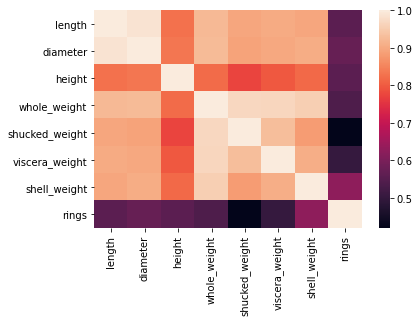

In [261]:
# Analisando a correlação entre os atributos
corrMatrix = df.corr()

sns.heatmap(corrMatrix, annot=False)
plt.show()

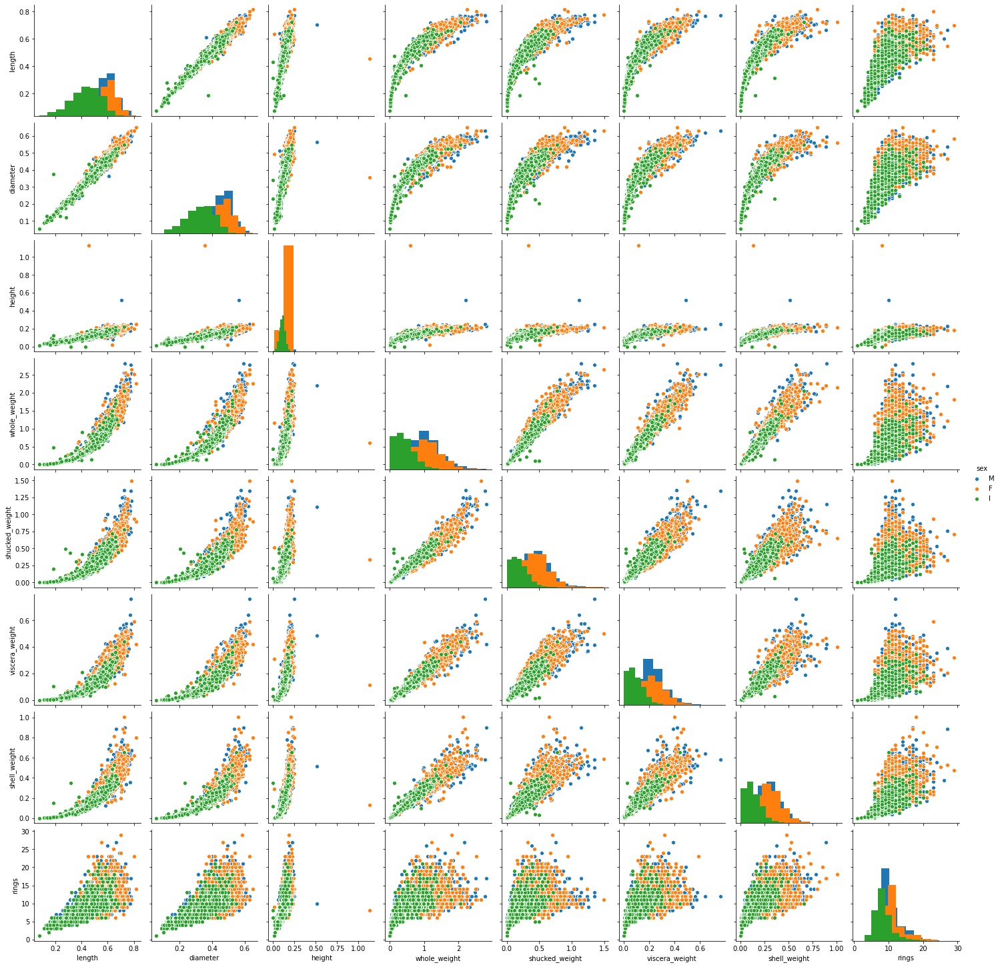

In [262]:
sns.pairplot(df, diag_kind="hist", hue="sex")

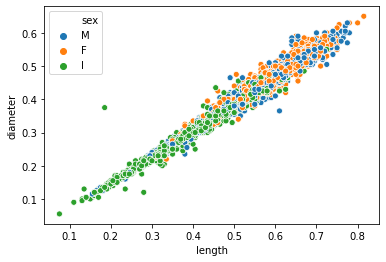

In [263]:
# Analise da anatomia das amostras por sexo (comprimento x diâmetro).  
sns.scatterplot(x='length', y='diameter', hue="sex", data=df)

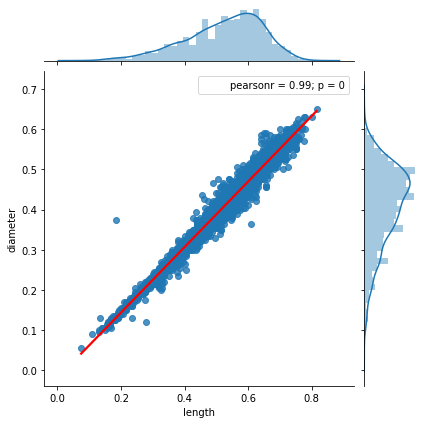

In [264]:
from scipy.stats import pearsonr

sns.jointplot(x="length", y="diameter", data=df, kind='reg', stat_func=pearsonr,
                  joint_kws={'line_kws':{'color':'red'}})

In [307]:
# removendo atributos e separando target
X = df.drop(['rings', 'sex'], axis=1) 

# Aplicando encoder no atributo sex
#encoder = preprocessing.LabelEncoder()
#X['sex'] = encoder.fit_transform(X.sex)

scaler = StandardScaler()
scaled_features = scaler.fit_transform(X)
X = pd.DataFrame(scaled_features,columns=X.columns)

# Aplicando PCA
#pca = PCA(n_components=2)
#principalComponents = pca.fit_transform(X)
#X = pd.DataFrame(data = principalComponents)

y = df['rings']

In [308]:
X.head()

,length,diameter,height,whole_weight,shucked_weight,viscera_weight,shell_weight
0,-0.574558,-0.432149,-1.064424,-0.641898,-0.607685,-0.726212,-0.638217
1,-1.448986,-1.439929,-1.183978,-1.230277,-1.170910,-1.205221,-1.212987
2,0.050033,0.122130,-0.107991,-0.309469,-0.463500,-0.356690,-0.207139
3,-0.699476,-0.432149,-0.347099,-0.637819,-0.648238,-0.607600,-0.602294
4,-1.615544,-1.540707,-1.423087,-1.272086,-1.215968,-1.287337,-1.320757


In [309]:
X_train, X_test, y_train, y_test = train_test_split(X, y,  test_size=0.30, random_state=1)

In [310]:
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
lr_model.coef_

array([-0.31396473,  1.52286167,  0.4308251 ,  4.45060336, -4.51537767,
       -0.96343354,  1.15995816])

In [314]:
y_test[:10]

<class 'pandas.core.series.Series'>


In [315]:
lr_model.predict(X_test)[:10]

<class 'numpy.ndarray'>


In [328]:
df_compare = pd.DataFrame({'Test':y_test, 'Predict': lr_model.predict(X_test).round()})
df_compare['error'] = df_compare['Test'] - df_compare['Predict']
df_compare.head(10)

,Test,Predict,error
17,10,9.0,1.0
1131,8,7.0,1.0
299,9,8.0,1.0
1338,10,9.0,1.0
2383,16,10.0,6.0
2039,6,6.0,0.0
3127,9,11.0,-2.0
791,10,10.0,0.0
3599,12,10.0,2.0
1566,9,9.0,0.0


In [323]:
# com atributo sex           - RMSE = 2.65
# sem atributo sex e PCA     - RMSE = 2.66
# sem atributo sex e sem PCA - RMSE = 2.22

RMSE = mean_squared_error(y_test, lr_model.predict(X_test))**0.5
RMSE

2.222009587727203